# The logistic map

We are interested in the following recursion relation
$$x_{n+1} = ax_n (1-x_n) $$
(see Goldstein's Classical Mechanics textbook Sec 11.8 for more details)

In [1]:
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

To get started, we generate a series with the above recursion relation

In [47]:
def logistic(a, x0) :
    x = np.zeros(5000) 
    x[0] = x0
    for j in range(1,len(x)) :
        x[j] = a*x[j-1]*(1-x[j-1])
    return x

We look at $a=3.56$ and $x_0=0.71$ and its last 40 data points. It oscillates between four values.

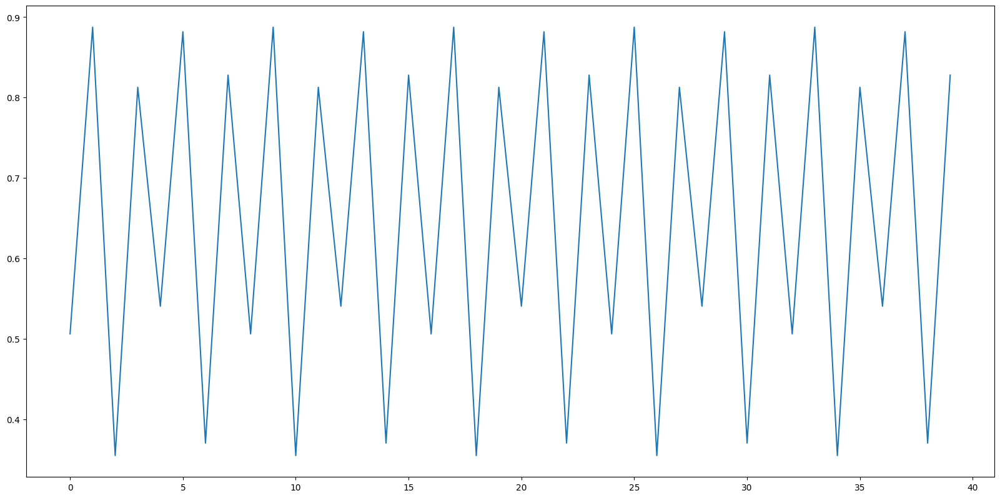

In [3]:
plt.figure(figsize=(20,10), dpi=100)
plt.plot(logistic(3.55,0.71)[-40:])
plt.show()

Let's now build a function to get the asymptotic values for a given $a$. The strategy will be to build a list using the recusion relation above and then get the unique elements from the last 200 values.

In [4]:
def logistic_asymp(a, x0) :
    x = np.zeros(2000) 
    x[0] = x0
    for j in range(1,len(x)) :
        x[j] = a*x[j-1]*(1-x[j-1])
    # look at the last 200 values and find the unique elements        
    xlist = list(set(np.round(x[-200:],4))) 
    # make a list of the same length with a-values
    alist = np.full(len(xlist), a)
    # return a list of the form [(a,x1),(a,x2),...]
    return list(zip(alist, xlist))

We now gather the data for $a$ ranging from 2.7 to 4.0. I have chosen $x=0.3$ but the final result is independent of the choice of $x$ as long as $0<x<1$.

In [136]:
data = []

for j in np.arange(2.7,4,0.0005) :
        newdata = logistic_asymp(j,0.3)
        data = data + newdata

## Bifurcations and Figenbaum plots

This is the Figenbaum plot

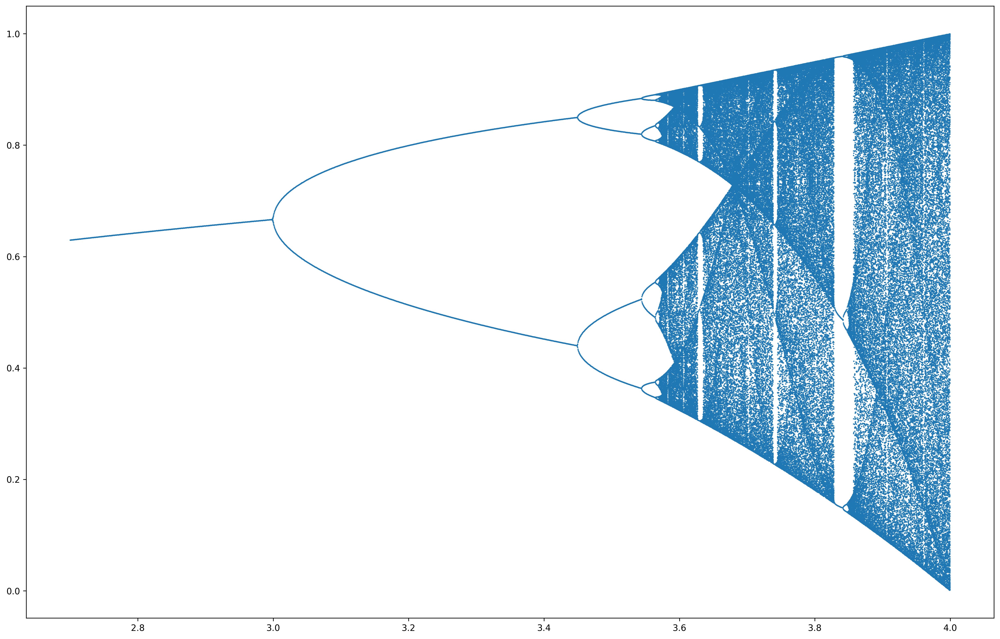

In [137]:
plt.figure(figsize=(20,13), dpi=300)

x_val = [x[0] for x in data]
y_val = [x[1] for x in data]

plt.scatter(x_val,y_val, s=0.3)

We now zoom into various regions of the above plot

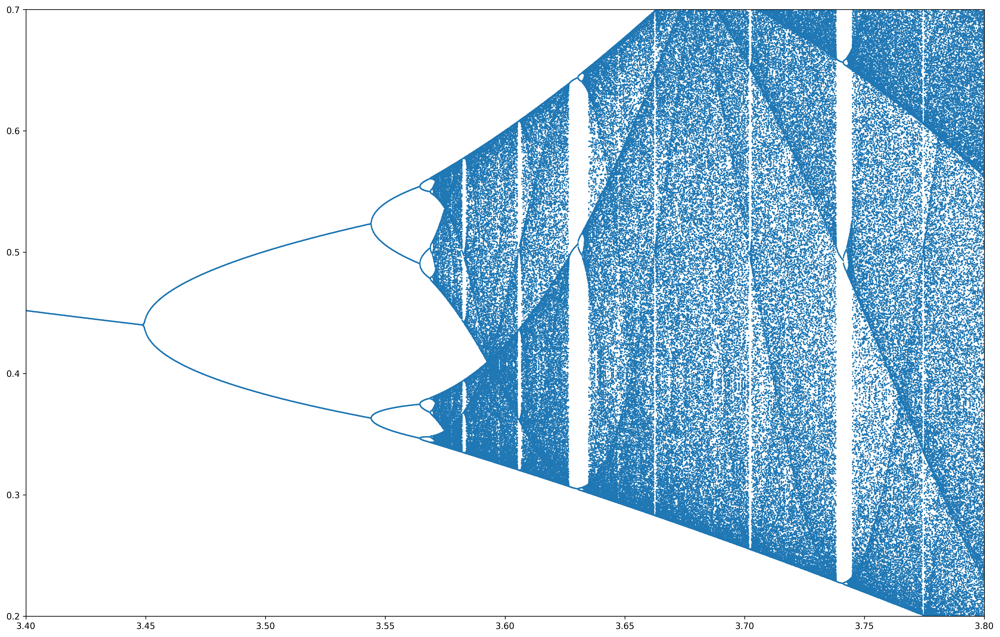

In [131]:
plt.figure(figsize=(20,13), dpi=300)

plt.ylim([0.2, 0.7])
plt.xlim([3.4, 3.8])
plt.scatter(x_val,y_val, s=0.5)

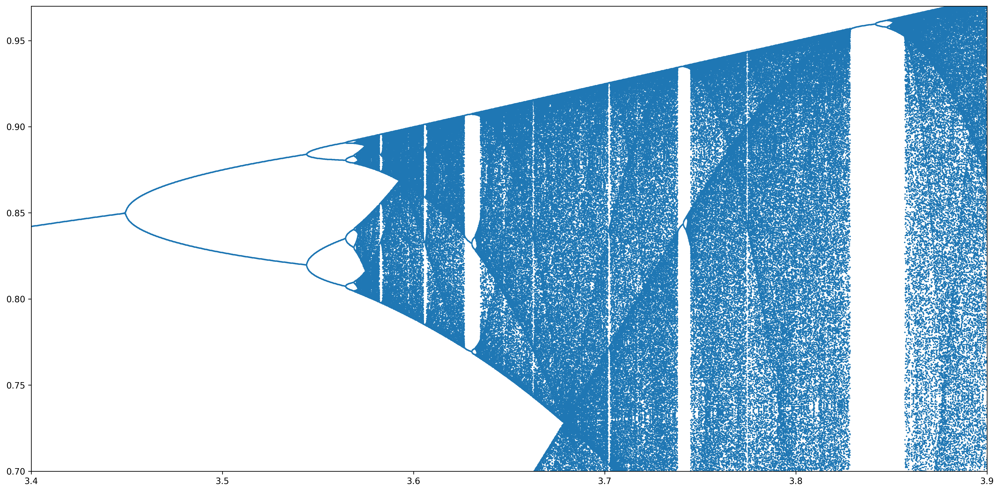

In [132]:
plt.figure(figsize=(20,10), dpi=300)

plt.ylim([0.7, 0.97])
plt.xlim([3.4, 3.9])
plt.scatter(x_val,y_val, s=0.5)

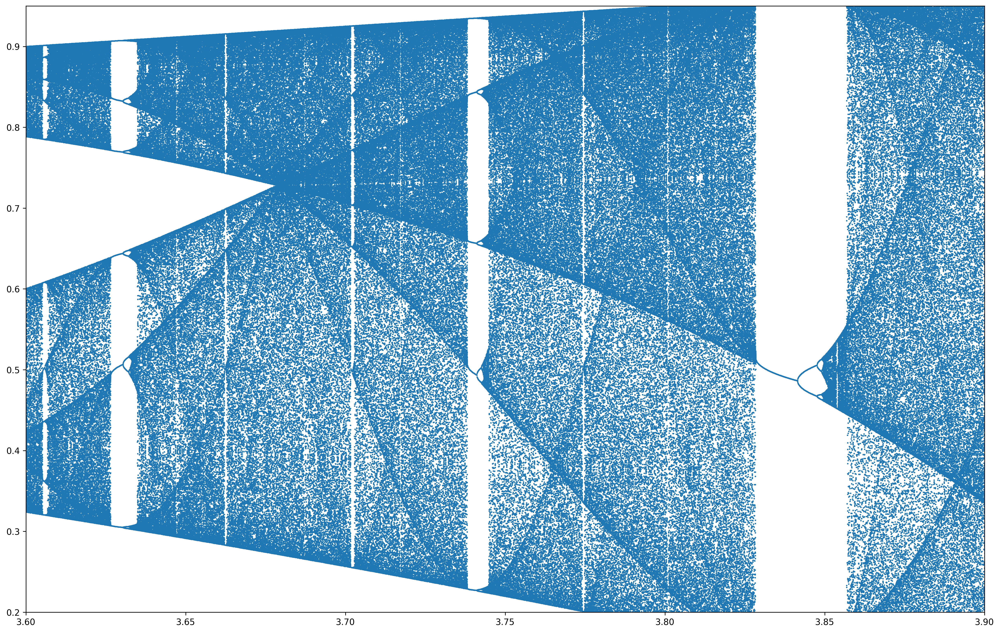

In [133]:
plt.figure(figsize=(20,13), dpi=300)

plt.xlim([3.6, 3.9])
plt.ylim([0.2, 0.95])
plt.scatter(x_val,y_val, s=0.5)

## Lyapunov exponent

Let's now look at the Lyapunov exponent. Consider starting with $x_0$ and $x'_0 = x_0+ \delta x_0$. We call the logistic map as $f(x)$ for the time being. At the $n$th step, the difference between $x'_n$ and $x_n$ is 
$$ \delta x_n = x'_n-x_n = f(x'_{n-1}) - f(x_{n-1}) \approx f'(x_{n-1}) \delta x_{n-1}$$
From this we have
$$ \left|\delta x_n \over \delta x_0 \right| = \prod_{j=0}^{n-1} |f'(x_j)| \equiv e^{\lambda n}$$
The Lyapunov exponent is therefore
$$ \lambda_L \approx \frac{1}{n} \sum_{j=1}^{n} \log |f'(x_j)| = \frac{1}{n} \sum_{j=1}^{n} \log |a(1-2x_n)| $$

In [64]:
def lyapunov(a, x0) :
    logisticData = logistic(a, x0)
    fp = lambda x: np.log(abs(a*(1 - 2*x)))
    toLog = np.vectorize(fp)
    logs = toLog(logisticData)
    return [(a,np.mean(logs))]

In [65]:
lyapunov(3.5, 0.3)

[(3.5, -0.8691885623676828)]

In [77]:
lyaData = []

for j in np.arange(3.4,4.0,0.0005) :
        newdata = lyapunov(j,0.7)
        lyaData = lyaData + newdata

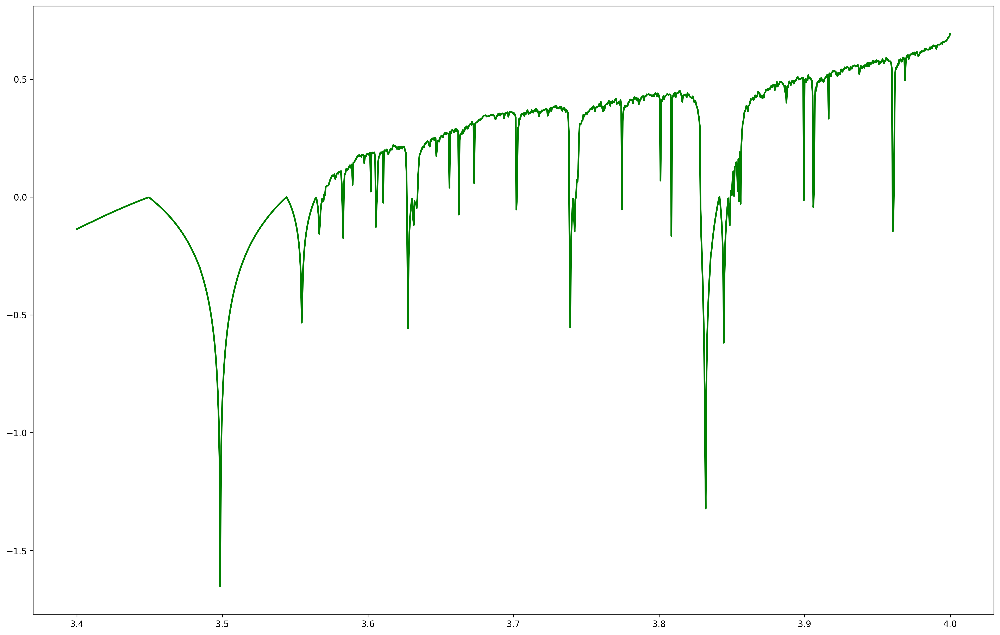

In [78]:
plt.figure(figsize=(20,13), dpi=300)

x_val = [x[0] for x in lyaData]
y_val = [x[1] for x in lyaData]

plt.plot(x_val,y_val, linewidth=2, color = "green")

## Where do the bifurcations occur?

In [138]:
from itertools import groupby

numBif = []

for grp, elmts in groupby(data, lambda x: x[0]):
    numBif = numBif + [(grp, len(list(elmts)))]

In [155]:
bifs = []

for j in range(1,len(numBif)) :
    if numBif[j][0] >  3.57 :
        break
    else :
        if numBif[j][1] == 2*(numBif[j-1][1]):
            bifs = bifs + [numBif[j][0]]
 
bifs

[2.996500000000099,
 2.9975000000000995,
 3.44850000000025,
 3.564500000000289,
 3.5690000000002904]

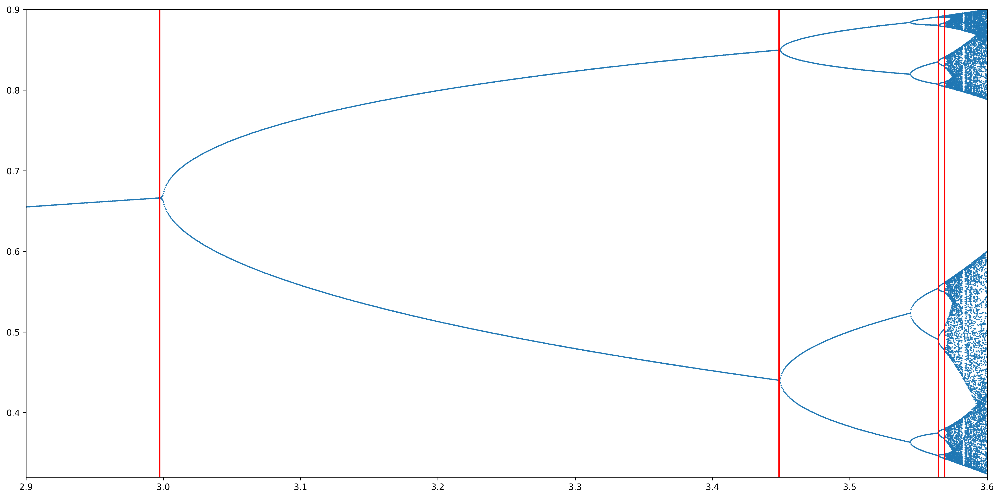

In [158]:
plt.figure(figsize=(20,10), dpi=300)

x_val = [x[0] for x in data]
y_val = [x[1] for x in data]

plt.xlim([2.9, 3.6])
plt.ylim([0.32, 0.9])
plt.vlines(x=bifs[1:], ymin = 0.3, ymax = 0.9, colors = 'red')
plt.scatter(x_val,y_val, s=0.3)